<a href="https://colab.research.google.com/github/SatriaImawan12/Customer-Segmentation-and-Profiling-by-Modified-LRFM-Analysis-using-CLARA-Algorithm-/blob/main/Modelling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1. Ekstraksi Data**

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import pandas as pd

url = 'https://raw.githubusercontent.com/rahmadkholid/DatAvengers/main/df_master_agg.csv'
df = pd.read_csv(url)
df

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,length_norm,skor_recency_norm,money_per_freq_norm
0,SC1101012001002,339,42,29,2440000.0,0.023810,84137.931034,2,1,5,0.741794,0.021142,0.061191
1,SC1101012001003,377,21,25,2461600.0,0.047619,98464.000000,3,1,5,0.824945,0.045017,0.071610
2,SC1101012002001,425,2,29,2470000.0,0.500000,85172.413793,5,5,5,0.929978,0.498634,0.061944
3,SC1101012002002,366,2,32,2670000.0,0.500000,83437.500000,3,5,5,0.800875,0.498634,0.060682
4,SC1101012003001,386,28,28,2080000.0,0.035714,74285.714286,3,1,5,0.844639,0.033080,0.054026
...,...,...,...,...,...,...,...,...,...,...,...,...,...
96581,SC1212202003002,32,367,0,0.0,0.002725,0.000000,1,1,1,0.070022,0.000000,0.000000
96582,SC1212192004002,21,367,0,0.0,0.002725,0.000000,1,1,1,0.045952,0.000000,0.000000
96583,SC1212032006002,90,367,0,0.0,0.002725,0.000000,1,1,1,0.196937,0.000000,0.000000
96584,SC1212222006002,36,367,0,0.0,0.002725,0.000000,1,1,1,0.078775,0.000000,0.000000


# **2. Model Awal (Parameter Default)**

In [ ]:
# Install sklearn-extra to use CLARA algorithm
!pip install scikit-learn-extra

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 7.6 MB/s eta 0:00:00


In [ ]:
# Install yellowbrick to vizualize the silhouette plot
!pip install yellowbrick

Silhouette plot digunakan untuk menampilkan kualitas model yang dilihat dari nilai silhouette score yang berkisar dari -1 hingga 1 dengan penjelasan berikut.
* `Score = 0` artinya terdapat cluster yang overlapping (1 objek dikelompokkan ke dalam lebih dari 1 cluster).
* `Score mendekati -1` artinya sebagian objek dikelompokkan ke dalam cluster yang salah.
* `Score mendekati 1` artinya objek dikelompokkan ke dalam cluster yang sesuai.

Selain dilihat dari silhouette score, pada sihouette plot, pemilihan model terbaik juga dilandasi oleh dua kriteria tambahan berikut.
* Semua cluster harus memiliki silhouette score yang lebih besar dari rata-rata score dataset.
* Tidak ada fluktuasi yang besar dalam ukuran cluster.

In [ ]:
# Siapkan data untuk clustering
X = df[['length_norm','skor_recency_norm','money_per_freq_norm']].values

The average silhouette score for initial model (default parameters) is: 0.419


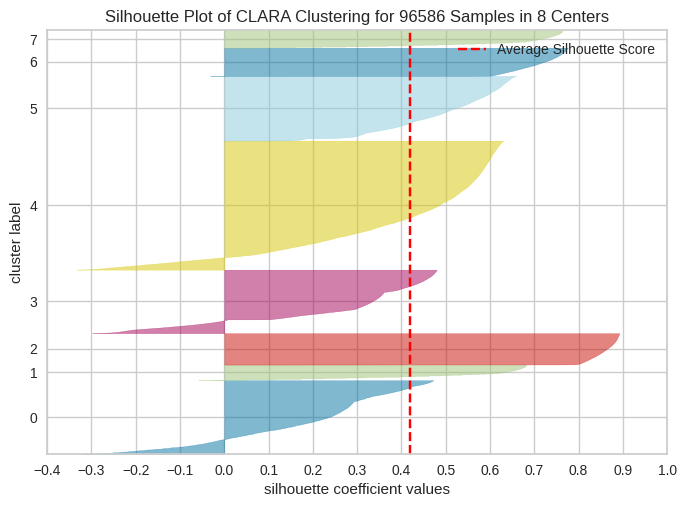

<Axes: title={'center': 'Silhouette Plot of CLARA Clustering for 96586 Samples in 8 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [ ]:
import time
import numpy as np
from sklearn_extra.cluster import CLARA
from yellowbrick.cluster import SilhouetteVisualizer

# Inisialisasi CLARA (default parameters)
clara = CLARA(random_state=42)

# Waktu awal
t0 = time.time()

# Fit model CLARA
clara.fit(X)

# Waktu akhir
t1 = time.time()

# Prediksi klaster
if hasattr(clara, "labels_"):
    labels = clara.labels_.astype(int)
else:
    labels = clara.predict(X)
unique_labels = set(labels)

# Ambil pusat (medoid) dari setiap klaster
medoids = clara.cluster_centers_
medoids_idx = clara.medoid_indices_.tolist()

# Hitung rata-rata silhouette score dan visualisasinya
visualizer = SilhouetteVisualizer(clara, colors='yellowbrick')
visualizer.fit(X)
avg_score = visualizer.silhouette_score_
individual_score = visualizer.silhouette_samples_
print(f"The average silhouette score for initial model (default parameters) is: {avg_score:.3f}")
visualizer.show()

In [ ]:
import plotly.graph_objects as go

# Buat figure
fig = go.Figure()

# Scatter plot 3D untuk anggota klaster
for label in unique_labels:
    cluster_mask = (labels == label)
    fig.add_trace(go.Scatter3d(
        x=df.loc[cluster_mask, 'length'],
        y=df.loc[cluster_mask, 'skor_recency'],
        z=df.loc[cluster_mask, 'money_per_freq'],
        mode='markers',
        marker=dict(
            size=10,
            color=label,
        ),
        text=[f"cluster: {label}<br>length: {l}<br>skor_recency: {r}<br>money_per_freq: {mf}" for l, r, mf in zip(df.loc[cluster_mask, 'length'], df.loc[cluster_mask, 'skor_recency'], df.loc[cluster_mask, 'money_per_freq'])],
        hoverinfo='text',
        opacity=0.8,
        name=f"Cluster {label}",
    ))

# Scatter plot 3D untuk pusat klaster (medoids) dengan hover label cluster
medoid_hover_texts = [
    f"cluster: {label}<br>length: {df.loc[medoids_idx, 'length'].iloc[i]}<br>skor_recency: {df.loc[medoids_idx, 'skor_recency'].iloc[i]}<br>money_per_freq: {df.loc[medoids_idx, 'money_per_freq'].iloc[i]}"
    for i, label in enumerate(labels[medoids_idx])
]

fig.add_trace(go.Scatter3d(
    x=df.loc[medoids_idx, 'length'],
    y=df.loc[medoids_idx, 'skor_recency'],
    z=df.loc[medoids_idx, 'money_per_freq'],
    mode='markers',
    marker=dict(
        size=10,
        color='black',
        symbol='x',
        opacity=1,
    ),
    text=medoid_hover_texts,
    hoverinfo='text',
    name=f"Medoids",
))

# Atur label sumbu dan tampilan layout
fig.update_layout(
    scene=dict(
        xaxis_title='length',
        yaxis_title='skor_recency',
        zaxis_title='money_per_freq',
    ),
    title=f"CLARA with {df.shape[0]} samples | Computing Time: {'%.2fs' % (t1 - t0)} | Avg Silhouette Score: {avg_score:.3f}<br><span style='font-size:14px;'>Parameters: n_clusters=8, init='build', n_sampling=None</span>",
    width=800,
    height=600,
    showlegend=True,
    scene_aspectmode='cube',  # Biar sumbu memiliki skala yang sama
)

# Tampilkan plot
fig.show()

In [ ]:
# Menyimpan label cluster, medoid, dan silhouette score untuk tiap pengguna
df['cluster_label'] = labels
df['is_medoid'] = df.index.isin(medoids_idx)
df['sil_score'] = individual_score

In [ ]:
# Menghitung banyak pengguna dalam tiap 'cluster_label'
value_counts = df['cluster_label'].value_counts()

# Membuat DataFrame dengan kolom 'cluster_label' dan 'counts'
result_df = pd.DataFrame({
    'cluster_label': value_counts.index,
    'counts': value_counts.values
})

# Tampilkan
result_df.sort_values('cluster_label', ignore_index=True)

,cluster_label,counts
0,0,16764
1,1,3561
2,2,7156
3,3,14492
4,4,29447
5,5,14771
6,6,6415
7,7,3980


In [ ]:
# Pengguna yang menjadi pusat (medoid) tiap cluster
df[df['is_medoid']].sort_values('cluster_label')

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,length_norm,skor_recency_norm,money_per_freq_norm,cluster_label,is_medoid,sil_score
74899,SC3325082004006,413,7,29,2004500.0,0.142857,69120.689655,4,2,4,0.903720,0.140515,0.050270,0,True,0.337812
94857,SC3323102012007,73,367,0,0.0,0.002725,0.000000,1,1,1,0.159737,0.000000,0.000000,1,True,0.673608
82499,SC3328122006003,408,1,31,1765900.0,1.000000,56964.516129,4,5,4,0.892779,1.000000,0.041429,2,True,0.890342
87842,SC3374121009011,393,4,36,1532600.0,0.250000,42572.222222,4,3,3,0.859956,0.247951,0.030962,3,True,0.357821
66867,SC3321062014007,376,29,31,1500000.0,0.034483,48387.096774,3,1,3,0.822757,0.031845,0.035191,4,True,0.538786
37852,SC3307091002006,433,15,30,1711100.0,0.066667,57036.666667,5,1,4,0.947484,0.064117,0.041481,5,True,0.627725
2,SC1101012002001,425,2,29,2470000.0,0.500000,85172.413793,5,5,5,0.929978,0.498634,0.061944,6,True,0.723351
95139,SC3307122008012,21,367,0,0.0,0.002725,0.000000,1,1,1,0.045952,0.000000,0.000000,7,True,0.756338


In [ ]:
# Pengguna yang memiliki sil_score <= 0
df[df['sil_score']<=0]

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,length_norm,skor_recency_norm,money_per_freq_norm,cluster_label,is_medoid,sil_score
30,SC1101022007002,399,12,36,1622400.0,0.083333,45066.666667,4,1,3,0.873085,0.080829,0.032776,0,False,-0.180772
41,SC1101022011001,374,5,42,2255700.0,0.200000,53707.142857,3,2,3,0.818381,0.197814,0.039060,3,False,-0.029533
47,SC1101022012001,367,5,37,2122000.0,0.200000,57351.351351,3,2,4,0.803063,0.197814,0.041710,3,False,-0.004645
61,SC1101022018003,417,9,42,1965100.0,0.111111,46788.095238,4,2,3,0.912473,0.108682,0.034028,0,False,-0.105348
69,SC1101022020008,417,10,37,2214800.0,0.100000,59859.459459,4,1,4,0.912473,0.097541,0.043534,0,False,-0.284354
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96083,SC1205172013014,48,367,0,0.0,0.002725,0.000000,1,1,1,0.105033,0.000000,0.000000,1,False,-0.026018
96113,SC1205072003002,48,367,0,0.0,0.002725,0.000000,1,1,1,0.105033,0.000000,0.000000,1,False,-0.026018
96235,SC1217032014001,48,367,0,0.0,0.002725,0.000000,1,1,1,0.105033,0.000000,0.000000,1,False,-0.026018
96384,SC1208182006006,48,367,0,0.0,0.002725,0.000000,1,1,1,0.105033,0.000000,0.000000,1,False,-0.026018


Parameter default: `sklearn_extra.cluster.CLARA(n_clusters=8, metric='euclidean', init='build', max_iter=300, n_sampling=None, n_sampling_iter=5, random_state=None)`

Silhouette plot hasil model awal CLARA dengan parameter default di atas, diperoleh informasi berikut.
* Silhouette score = 0.419 termasuk nilai yang kecil karena walaupun nilainya lebih dari 0, tetapi masih cukup jauh menuju 1.
* Semua cluster memiliki silhouette score lebih besar dari rata-rata score dataset. Berdasarkan kriteria tambahan silhouette plot, hal tersebut terpenuhi.
* Terdapat 9182 objek yang memiliki silhouette score < 0. Artinya objek-objek tersebut dikelompokkan ke dalam cluster yang salah.

Berdasarkan ketiga informasi tersebut, kualitas model awal CLARA dengan parameter default dapat dikatakan belum cukup baik karena dari tiga kriteria pemilihan model, model tersebut hanya memenuhi salah satunya saja. Oleh karena itu, akan dilakukan evaluasi model dengan parameter yang disesuaikan untuk mendapatkan model terbaik.

# **3. Evaluasi**

Evaluating parameters: {'init': 'random', 'n_clusters': 2, 'n_sampling': None, 'random_state': 42}
For params = {'init': 'random', 'n_clusters': 2, 'n_sampling': None, 'random_state': 42}, the average silhouette score is: 0.706
Evaluating parameters: {'init': 'random', 'n_clusters': 2, 'n_sampling': 100, 'random_state': 42}
For params = {'init': 'random', 'n_clusters': 2, 'n_sampling': 100, 'random_state': 42}, the average silhouette score is: 0.564
Evaluating parameters: {'init': 'random', 'n_clusters': 3, 'n_sampling': None, 'random_state': 42}
For params = {'init': 'random', 'n_clusters': 3, 'n_sampling': None, 'random_state': 42}, the average silhouette score is: 0.410
Evaluating parameters: {'init': 'random', 'n_clusters': 3, 'n_sampling': 100, 'random_state': 42}
For params = {'init': 'random', 'n_clusters': 3, 'n_sampling': 100, 'random_state': 42}, the average silhouette score is: 0.771
Evaluating parameters: {'init': 'random', 'n_clusters': 4, 'n_sampling': None, 'random_state

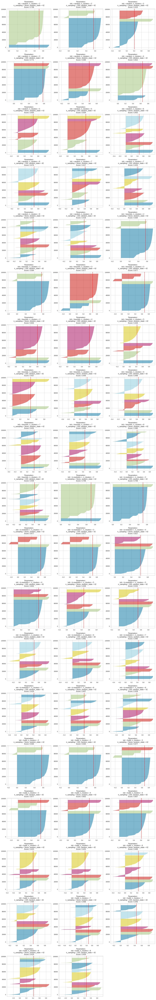

In [ ]:
import matplotlib.pyplot as plt
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn_extra.cluster import CLARA
import numpy as np
from joblib import Parallel, delayed
from sklearn.model_selection import ParameterGrid

def format_params(params):
    param_list = [f"{key} = {value}" for key, value in params.items()]
    formatted_params = ''
    for i in range(0, len(param_list), 2):
        # Gabungkan dua parameter per baris
        formatted_params += ', '.join(param_list[i:i+2]) + '\n'
    return formatted_params.strip()

# Fungsi evaluasi CLARA
def evaluate_clara(params, ax):
    print(f"Evaluating parameters: {params}")  # Debug statement
    try:
        model = CLARA(**params)
        visualizer = SilhouetteVisualizer(model, colors='yellowbrick', ax=ax)
        visualizer.fit(X)
        score = visualizer.silhouette_score_

        # Format parameter untuk ditampilkan secara vertikal
        formatted_params = format_params(params)

        ax.set_title(f"Parameters:\n{formatted_params}\nScore: {score:.3f}")
        print(f"For params = {params}, the average silhouette score is: {score:.3f}")
    except Exception as e:
        print(f"Error for params {params}: {e}")  # Debug statement

# Definisi grid parameter
param_grid = {
    'n_clusters': [2, 3, 4, 5, 6, 7, 8],
    'n_sampling': [None, 100],
    'init': ['random', 'heuristic', 'k-medoids++', 'build'],
    'random_state': [42]
}

# Membuat grid kombinasi parameter
grid = list(ParameterGrid(param_grid))

# Hitung jumlah kombinasi parameter
num_combinations = len(grid)

# Tentukan ukuran grid plot berdasarkan jumlah kombinasi parameter
n_cols = 3  # Jumlah kolom tetap 3
n_rows = (num_combinations // n_cols) + (num_combinations % n_cols > 0)  # Hitung jumlah baris yang dibutuhkan

# Membuat subplot sesuai ukuran grid
fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
ax = ax.flatten()  # Flatten untuk memudahkan indexing dalam loop

# Loop melalui setiap kombinasi parameter tanpa paralel
for idx, params in enumerate(grid):
    evaluate_clara(params, ax[idx])

# Menghapus sumbu kosong jika ada
for i in range(len(grid), len(ax)):
    fig.delaxes(ax[i])

# Mengatur layout plot agar tidak saling tumpang tindih
plt.tight_layout()

# Menampilkan plot
plt.show()


Berdasarkan silhouette plot hasil evaluasi awal dengan 56 kombinasi parameter di atas, diperoleh insight berikut.
* `n_clusters = 2` dieliminasi karena dinilai kurang insightful (seperti hanya diinterpretasikan Ya/Tidak) dalam analisis clustering pelanggan.
* Pada `init = 'heuristic'` dan `init = 'build'` terlihat memiliki lebih banyak jumlah objek yang dikelompokkan ke cluster yang salah dibanding `init = 'k-medoids++'` dan `init = 'random'`.
* Di antara semua `n_clusters` pada `init = 'k-medoids++'` dan `init = 'random'`, terlihat hasil jumlah objek yang dikelompokkan ke cluster yang salah lebih sedikit pada `n_clusters = 3` atau `n_clusters = 4`. Oleh karena itu, akan dilakukan evaluasi lebih lanjut pada model dengan paramater `n_clusters = [3, 4]` dan `init = [k-medoids++, random]`.

Oleh karena itu, akan dilakukan evaluasi lanjutan berdasarkan hal-hal di atas dengan mempertimbangkan penambahan n_sampling untuk melihat apakah memiliki pengaruh dalam kinerja model.

Evaluating parameters: {'init': 'random', 'n_clusters': 3, 'n_sampling': 300, 'random_state': 42}
For params = {'init': 'random', 'n_clusters': 3, 'n_sampling': 300, 'random_state': 42}, the average silhouette score is: 0.677
Evaluating parameters: {'init': 'random', 'n_clusters': 4, 'n_sampling': 300, 'random_state': 42}
For params = {'init': 'random', 'n_clusters': 4, 'n_sampling': 300, 'random_state': 42}, the average silhouette score is: 0.592
Evaluating parameters: {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 300, 'random_state': 42}
For params = {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 300, 'random_state': 42}, the average silhouette score is: 0.677
Evaluating parameters: {'init': 'k-medoids++', 'n_clusters': 4, 'n_sampling': 300, 'random_state': 42}
For params = {'init': 'k-medoids++', 'n_clusters': 4, 'n_sampling': 300, 'random_state': 42}, the average silhouette score is: 0.652


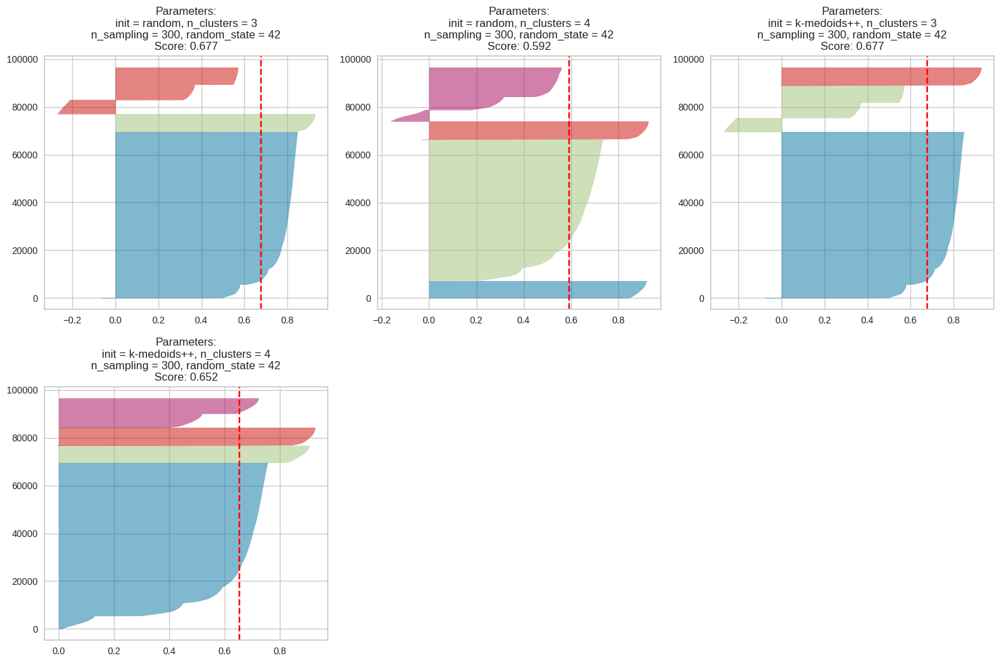

In [ ]:
import matplotlib.pyplot as plt
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn_extra.cluster import CLARA
import numpy as np
from joblib import Parallel, delayed
from sklearn.model_selection import ParameterGrid

def format_params(params):
    param_list = [f"{key} = {value}" for key, value in params.items()]
    formatted_params = ''
    for i in range(0, len(param_list), 2):
        # Gabungkan dua parameter per baris
        formatted_params += ', '.join(param_list[i:i+2]) + '\n'
    return formatted_params.strip()

# Fungsi evaluasi CLARA
def evaluate_clara(params, ax):
    print(f"Evaluating parameters: {params}")  # Debug statement
    try:
        model = CLARA(**params)
        visualizer = SilhouetteVisualizer(model, colors='yellowbrick', ax=ax)
        visualizer.fit(X)
        score = visualizer.silhouette_score_

        # Format parameter untuk ditampilkan secara vertikal
        formatted_params = format_params(params)

        ax.set_title(f"Parameters:\n{formatted_params}\nScore: {score:.3f}")
        print(f"For params = {params}, the average silhouette score is: {score:.3f}")
    except Exception as e:
        print(f"Error for params {params}: {e}")  # Debug statement

# Definisi grid parameter
param_grid = {
    'n_clusters': [3, 4],
    'n_sampling': [300],
    'init': ['random', 'k-medoids++'],
    'random_state': [42]
}

# Membuat grid kombinasi parameter
grid = list(ParameterGrid(param_grid))

# Hitung jumlah kombinasi parameter
num_combinations = len(grid)

# Tentukan ukuran grid plot berdasarkan jumlah kombinasi parameter
n_cols = 3  # Jumlah kolom tetap 3
n_rows = (num_combinations // n_cols) + (num_combinations % n_cols > 0)  # Hitung jumlah baris yang dibutuhkan

# Membuat subplot sesuai ukuran grid
fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
ax = ax.flatten()  # Flatten untuk memudahkan indexing dalam loop

# Loop melalui setiap kombinasi parameter tanpa paralel
for idx, params in enumerate(grid):
    evaluate_clara(params, ax[idx])

# Menghapus sumbu kosong jika ada
for i in range(len(grid), len(ax)):
    fig.delaxes(ax[i])

# Mengatur layout plot agar tidak saling tumpang tindih
plt.tight_layout()

# Menampilkan plot
plt.show()


Berdasarkan silhouette plot hasil evaluasi lanjutan, diperoleh bahwa hasil **model terbaiknya** adalah model dengan parameter `init = k-medoids++, n_clusters = 4, n_sampling = 300, random_state = 42` dan silhouette score = 0.652. Hal tersebut didukung juga dengan sedikitnya jumlah objek yang salah cluster. Plot di atas juga menunjukkan bahwa `init = k-medoids++` memberikan kinerja model yang lebih baik. Selanjutnya akan dilakukan percobaan pada init tersebut dengan penambahan n_clusters dan n_sampling.

Evaluating parameters: {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 300, 'random_state': 42}
For params = {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 300, 'random_state': 42}, the average silhouette score is: 0.677
Evaluating parameters: {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 500, 'random_state': 42}
For params = {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 500, 'random_state': 42}, the average silhouette score is: 0.771
Evaluating parameters: {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 1000, 'random_state': 42}
For params = {'init': 'k-medoids++', 'n_clusters': 3, 'n_sampling': 1000, 'random_state': 42}, the average silhouette score is: 0.771
Evaluating parameters: {'init': 'k-medoids++', 'n_clusters': 4, 'n_sampling': 300, 'random_state': 42}
For params = {'init': 'k-medoids++', 'n_clusters': 4, 'n_sampling': 300, 'random_state': 42}, the average silhouette score is: 0.652
Evaluating parameters: {'init': 'k-medoids++', 'n_clus

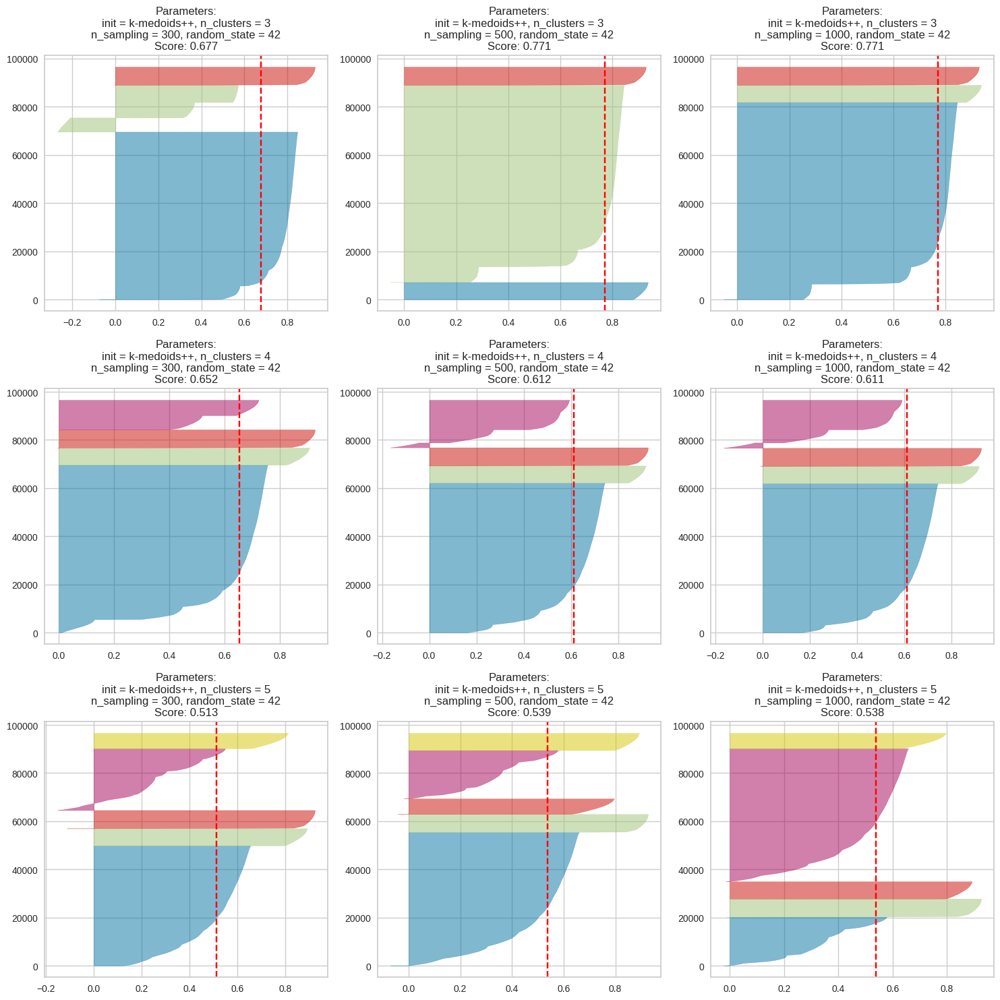

In [ ]:
import matplotlib.pyplot as plt
from yellowbrick.cluster import SilhouetteVisualizer
from sklearn_extra.cluster import CLARA
import numpy as np
from joblib import Parallel, delayed
from sklearn.model_selection import ParameterGrid

def format_params(params):
    param_list = [f"{key} = {value}" for key, value in params.items()]
    formatted_params = ''
    for i in range(0, len(param_list), 2):
        # Gabungkan dua parameter per baris
        formatted_params += ', '.join(param_list[i:i+2]) + '\n'
    return formatted_params.strip()

# Fungsi evaluasi CLARA
def evaluate_clara(params, ax):
    print(f"Evaluating parameters: {params}")  # Debug statement
    try:
        model = CLARA(**params)
        visualizer = SilhouetteVisualizer(model, colors='yellowbrick', ax=ax)
        visualizer.fit(X)
        score = visualizer.silhouette_score_

        # Format parameter untuk ditampilkan secara vertikal
        formatted_params = format_params(params)

        ax.set_title(f"Parameters:\n{formatted_params}\nScore: {score:.3f}")
        print(f"For params = {params}, the average silhouette score is: {score:.3f}")
    except Exception as e:
        print(f"Error for params {params}: {e}")  # Debug statement

# Definisi grid parameter
param_grid = {
    'n_clusters': [3, 4, 5],
    'n_sampling': [300, 500, 1000],
    'init': ['k-medoids++'],
    'random_state': [42]
}

# Membuat grid kombinasi parameter
grid = list(ParameterGrid(param_grid))

# Hitung jumlah kombinasi parameter
num_combinations = len(grid)

# Tentukan ukuran grid plot berdasarkan jumlah kombinasi parameter
n_cols = 3  # Jumlah kolom tetap 3
n_rows = (num_combinations // n_cols) + (num_combinations % n_cols > 0)  # Hitung jumlah baris yang dibutuhkan

# Membuat subplot sesuai ukuran grid
fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
ax = ax.flatten()  # Flatten untuk memudahkan indexing dalam loop

# Loop melalui setiap kombinasi parameter tanpa paralel
for idx, params in enumerate(grid):
    evaluate_clara(params, ax[idx])

# Menghapus sumbu kosong jika ada
for i in range(len(grid), len(ax)):
    fig.delaxes(ax[i])

# Mengatur layout plot agar tidak saling tumpang tindih
plt.tight_layout()

# Menampilkan plot
plt.show()


Berdasarkan silhouette plot di atas, jika ditinjau dari silhouette score, n_clusters = 3 dan 4 memberikan score lebih tinggi dibandingkan n_clusters = 5. Pada n_clusters = 3, penambahan n_sampling terlihat cenderung memiliki pengaruh baik terhadap model dengan menghasilkan score lebih tinggi dan objek yang salah cluster juga lebih sedikit. Namun, pada n_clusters = 4, penambahan n_sampling tampak memperburuk model.

Dengan mempertimbangkan insight/solusi bisnis, n_cluster = 3 dinilai kurang menarik karena terlalu terbatas jika diterapkan untuk analisis segmentasi pelanggan, fluktuasi dalam ukuran cluster juga besar. Oleh karena itu, dapat dikatakan **model terbaik**nya adalah model dengan parameter `init = k-medoids++, n_clusters = 4, n_sampling = 300, random_state = 42`

**Kesimpulan**

Berdasarkan hasil beberapa evaluasi model yang telah dilakukan, maka diperoleh **model terbaik CLARA** dengan parameter `init = k-medoids++, n_clusters = 4, n_sampling = 300, random_state = 42`

# **4. Model Akhir**

The average silhouette score for final model is: 0.652


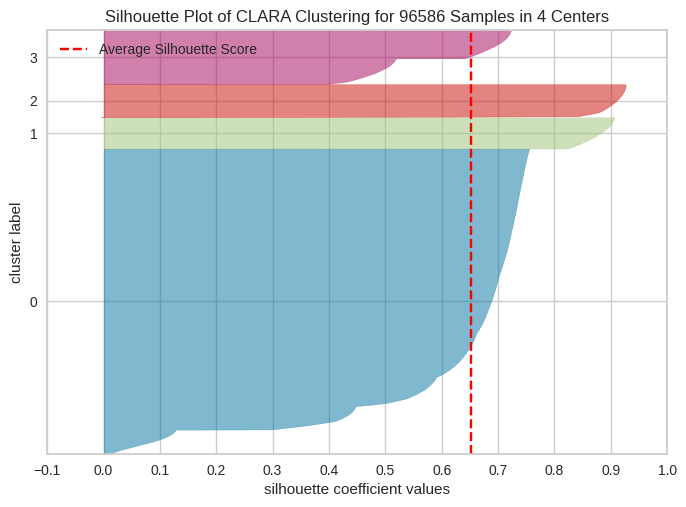

<Axes: title={'center': 'Silhouette Plot of CLARA Clustering for 96586 Samples in 4 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [ ]:
import time
import numpy as np
from sklearn_extra.cluster import CLARA
from yellowbrick.cluster import SilhouetteVisualizer

# Inisialisasi CLARA
clara = CLARA(n_clusters=4, init='k-medoids++', n_sampling=300, random_state=42)

# Waktu awal
t0 = time.time()

# Fit model CLARA
clara.fit(X)

# Waktu akhir
t1 = time.time()

# Prediksi klaster
if hasattr(clara, "labels_"):
    labels = clara.labels_.astype(int)
else:
    labels = clara.predict(X)
unique_labels = set(labels)

# Ambil pusat (medoid) dari setiap klaster
medoids = clara.cluster_centers_
medoids_idx = clara.medoid_indices_.tolist()

# Hitung rata-rata silhouette score, silhouette score tiap objek, dan visualisasinya
visualizer = SilhouetteVisualizer(clara, colors='yellowbrick')
visualizer.fit(X)
avg_score = visualizer.silhouette_score_
individual_score = visualizer.silhouette_samples_
print(f"The average silhouette score for final model is: {avg_score:.3f}")
visualizer.show()

In [ ]:
import plotly.graph_objects as go

# Buat figure
fig = go.Figure()

# Scatter plot 3D untuk anggota klaster
for label in unique_labels:
    cluster_mask = (labels == label)
    fig.add_trace(go.Scatter3d(
        x=df.loc[cluster_mask, 'length'],
        y=df.loc[cluster_mask, 'skor_recency'],
        z=df.loc[cluster_mask, 'money_per_freq'],
        mode='markers',
        marker=dict(
            size=10,
            color=label,
        ),
        text=[f"cluster: {label}<br>length: {l}<br>skor_recency: {r}<br>money_per_freq: {mf}" for l, r, mf in zip(df.loc[cluster_mask, 'length'], df.loc[cluster_mask, 'skor_recency'], df.loc[cluster_mask, 'money_per_freq'])],
        hoverinfo='text',
        opacity=0.8,
        name=f"Cluster {label}",
    ))

# Scatter plot 3D untuk pusat klaster (medoids) dengan hover label cluster
medoid_hover_texts = [
    f"cluster: {label}<br>length: {df.loc[medoids_idx, 'length'].iloc[i]}<br>skor_recency: {df.loc[medoids_idx, 'skor_recency'].iloc[i]}<br>money_per_freq: {df.loc[medoids_idx, 'money_per_freq'].iloc[i]}"
    for i, label in enumerate(labels[medoids_idx])
]

fig.add_trace(go.Scatter3d(
    x=df.loc[medoids_idx, 'length'],
    y=df.loc[medoids_idx, 'skor_recency'],
    z=df.loc[medoids_idx, 'money_per_freq'],
    mode='markers',
    marker=dict(
        size=10,
        color='black',
        symbol='x',
        opacity=1,
    ),
    text=medoid_hover_texts,
    hoverinfo='text',
    name=f"Medoids",
))

# Atur label sumbu dan tampilan layout
fig.update_layout(
    scene=dict(
        xaxis_title='length',
        yaxis_title='skor_recency',
        zaxis_title='money_per_freq',
    ),
    title=f"CLARA with {df.shape[0]} samples | Computing Time: {'%.2fs' % (t1 - t0)} | Avg Silhouette Score: {avg_score:.3f}<br><span style='font-size:14px;'>Parameters: n_clusters=4, init='k-medoids++', n_sampling=300</span>",
    width=800,
    height=600,
    showlegend=True,
    scene_aspectmode='cube',  # Biar sumbu memiliki skala yang sama
)

# Tampilkan plot
fig.show()

In [ ]:
# Menyimpan label cluster, medoid, dan silhouette score untuk tiap pengguna
df['cluster_label'] = labels
df['is_medoid'] = df.index.isin(medoids_idx)
df['sil_score'] = individual_score

# Memilih kolom penting
df = df[df.columns.difference(['length_norm','skor_recency_norm','money_per_freq_norm'], sort=False)]

# Tampilkan
df

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,cluster_label,is_medoid,sil_score
0,SC1101012001002,339,42,29,2440000.0,0.023810,84137.931034,2,1,5,0,False,0.630968
1,SC1101012001003,377,21,25,2461600.0,0.047619,98464.000000,3,1,5,0,False,0.722300
2,SC1101012002001,425,2,29,2470000.0,0.500000,85172.413793,5,5,5,3,False,0.702159
3,SC1101012002002,366,2,32,2670000.0,0.500000,83437.500000,3,5,5,3,False,0.638642
4,SC1101012003001,386,28,28,2080000.0,0.035714,74285.714286,3,1,5,0,False,0.738188
...,...,...,...,...,...,...,...,...,...,...,...,...,...
96581,SC1212202003002,32,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.923918
96582,SC1212192004002,21,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.915098
96583,SC1212032006002,90,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.846507
96584,SC1212222006002,36,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.925546


In [ ]:
# Menghitung banyak pengguna dalam tiap 'cluster_label'
value_counts = df['cluster_label'].value_counts()

# Membuat DataFrame dengan kolom 'cluster_label' dan 'counts'
result_df = pd.DataFrame({
    'cluster_label': value_counts.index,
    'counts': value_counts.values
})

# Tampilkan
result_df.sort_values('cluster_label')

,cluster_label,counts
0,0,69601
3,1,7156
2,2,7542
1,3,12287


Diperoleh informasi bahwa sebagian besar pelanggan berada dalam cluster 0.

In [ ]:
# Pengguna yang menjadi pusat (medoid) tiap cluster
df[df['is_medoid']].sort_values('cluster_label')

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,cluster_label,is_medoid,sil_score
3546,SC1110022004003,395,13,35,1607000.0,0.076923,45914.285714,4,1,3,0,True,0.753350
57579,SC3316112015001,413,1,33,1214200.0,1.000000,36793.939394,4,5,2,1,True,0.905098
89736,SC1111042063001,52,367,0,0.0,0.002725,0.000000,1,1,1,2,True,0.922830
27367,SC3302192017007,406,2,40,1769800.0,0.500000,44245.000000,4,5,3,3,True,0.722496


Tabel di atas menunjukkan pengguna yang menjadi pusat/acuan kriteria tiap cluster berturut-turut untuk `category_length`, `category_skor_recency`, dan `category_money_per_freq` sebagai berikut.
* Cluster 0: 413
* Cluster 1: 452
* Cluster 2: 111
* Cluster 3: 453

In [ ]:
# Pengguna yang memiliki sil_score <= 0
df[df['sil_score']<=0]

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,cluster_label,is_medoid,sil_score
9446,SC1205092011006,221,13,11,123000.0,0.076923,11181.818182,1,1,1,2,False,-0.004941
41543,SC3308202017007,200,3,11,773500.0,0.333333,70318.181818,1,4,4,2,False,-0.005188
51177,SC3313062008011,223,40,21,1341200.0,0.025000,63866.666667,1,1,4,2,False,-0.004871


Berdasarkan hasil model terbaik, hanya ada 3 dari 96586 pelanggan yang berada dalam cluster yang salah. Hal ini tidak berpengaruh secara signifikan terhadap solusi bisnis.

In [ ]:
# Menampilkan pengguna yang dikelompokkan dalam cluster 0
df[(df['cluster_label']==0)]

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,cluster_label,is_medoid,sil_score
0,SC1101012001002,339,42,29,2440000.0,0.023810,84137.931034,2,1,5,0,False,0.630968
1,SC1101012001003,377,21,25,2461600.0,0.047619,98464.000000,3,1,5,0,False,0.722300
4,SC1101012003001,386,28,28,2080000.0,0.035714,74285.714286,3,1,5,0,False,0.738188
5,SC1101012003002,431,5,26,2190000.0,0.200000,84230.769231,5,2,5,0,False,0.371928
6,SC1101012004001,378,45,19,1650000.0,0.022222,86842.105263,3,1,5,0,False,0.716498
...,...,...,...,...,...,...,...,...,...,...,...,...,...
89304,SC9171031008026,350,23,34,1670100.0,0.043478,49120.588235,2,1,3,0,False,0.675253
89305,SC9171031010019,435,7,45,1978200.0,0.142857,43960.000000,5,2,3,0,False,0.574433
89309,SC9171032007009,376,6,49,1838400.0,0.166667,37518.367347,3,2,2,0,False,0.572896
89310,SC9171042001001,380,13,27,1348900.0,0.076923,49959.259259,3,1,3,0,False,0.745099


In [ ]:
# Menampilkan pengguna yang dikelompokkan dalam cluster 1
df[df['cluster_label']==1]

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,cluster_label,is_medoid,sil_score
21,SC1101022005001,453,1,47,1560000.0,1.0,33191.489362,5,5,2,1,False,0.835095
23,SC1101022005003,386,1,47,1430000.0,1.0,30425.531915,3,5,2,1,False,0.881468
25,SC1101022006001,443,1,42,2440000.0,1.0,58095.238095,5,5,4,1,False,0.863850
28,SC1101022006004,406,1,44,2083700.0,1.0,47356.818182,4,5,3,1,False,0.905960
29,SC1101022007001,383,1,44,2320000.0,1.0,52727.272727,3,5,3,1,False,0.878211
...,...,...,...,...,...,...,...,...,...,...,...,...,...
89232,SC9115082007001,375,1,50,780800.0,1.0,15616.000000,3,5,1,1,False,0.850496
89263,SC9115142009001,386,1,31,610900.0,1.0,19706.451613,3,5,1,1,False,0.876820
89270,SC9115152008001,427,1,23,520000.0,1.0,22608.695652,5,5,1,1,False,0.889131
89278,SC9119032003003,379,1,52,1752600.0,1.0,33703.846154,3,5,2,1,False,0.867756


In [ ]:
# Menampilkan pengguna yang dikelompokkan dalam cluster 2
df[df['cluster_label']==2]

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,cluster_label,is_medoid,sil_score
59,SC1101022018001,82,5,8,367400.0,0.200000,45925.000000,1,2,3,2,False,0.678869
282,SC1101092003001,73,305,2,300000.0,0.003279,150000.000000,1,1,5,2,False,0.805840
633,SC1102052026001,73,3,13,610000.0,0.333333,46923.076923,1,4,3,2,False,0.540149
640,SC1102052027003,110,257,2,1210000.0,0.003891,605000.000000,1,1,5,2,False,0.381302
840,SC1102162003002,180,34,8,154100.0,0.029412,19262.500000,1,1,1,2,False,0.383534
...,...,...,...,...,...,...,...,...,...,...,...,...,...
96581,SC1212202003002,32,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.923918
96582,SC1212192004002,21,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.915098
96583,SC1212032006002,90,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.846507
96584,SC1212222006002,36,367,0,0.0,0.002725,0.000000,1,1,1,2,False,0.925546


In [ ]:
# Menampilkan pengguna yang dikelompokkan dalam cluster 3
df[df['cluster_label']==3]

,user_id,length,recency,frequency,monetary,skor_recency,money_per_freq,category_length,category_skor_recency,category_money_per_freq,cluster_label,is_medoid,sil_score
2,SC1101012002001,425,2,29,2470000.0,0.500000,85172.413793,5,5,5,3,False,0.702159
3,SC1101012002002,366,2,32,2670000.0,0.500000,83437.500000,3,5,5,3,False,0.638642
16,SC1101022002001,425,3,44,1985600.0,0.333333,45127.272727,5,4,3,3,False,0.510849
19,SC1101022002004,434,2,47,2226400.0,0.500000,47370.212766,5,5,3,3,False,0.700579
27,SC1101022006003,419,3,41,2012300.0,0.333333,49080.487805,4,4,3,3,False,0.516556
...,...,...,...,...,...,...,...,...,...,...,...,...,...
89306,SC9171031014007,435,3,40,2047100.0,0.333333,51177.500000,5,4,3,3,False,0.493355
89307,SC9171031014040,428,3,49,2585100.0,0.333333,52757.142857,5,4,3,3,False,0.506089
89308,SC9171031014043,386,3,37,2435900.0,0.333333,65835.135135,3,4,4,3,False,0.476400
89311,SC9171042002002,377,3,35,2150000.0,0.333333,61428.571429,3,4,4,3,False,0.449613


In [ ]:
# Memeriksa rata-rata silhouette score
df['sil_score'].mean()

0.6524537235154341

In [ ]:
# Memeriksa missing values
df.isna().sum()

user_id                    0
length                     0
recency                    0
frequency                  0
monetary                   0
skor_recency               0
money_per_freq             0
category_length            0
category_skor_recency      0
category_money_per_freq    0
cluster_label              0
is_medoid                  0
sil_score                  0
dtype: int64

In [ ]:
# Ekspor df hasil clustering
df.to_csv('cluster.csv', index=False)